<a href="https://colab.research.google.com/github/reinaldo-rosa-inpe/GEEBonfimJr./blob/main/Goes16Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Statistical analysis of GOES-16 reflectance data through Cullen-Frey graph**

 ---

**Load necessary libraries and auxiliar functions**

In [1]:
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.preprocessing import MinMaxScaler
#from scipy.stats import norm, genextreme, skew, kurtosis
from scipy.stats import skew, kurtosis
from google.colab import data_table
data_table._DEFAULT_FORMATTERS[float] = lambda x: f"{x:.4f}"
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [2]:
# To produce a list whose itens are timeseries from pandas columns
def makeList(data, npoints):
  """
  Produce a list whose itens are timeseries 
  data    : pandas dataframe with columns beeing timeseries
  """
  lst = []
  n = len(data.columns) 
  for i in range(n):
    ns = len(data.iloc[:,i])
    # if total values is greater than user specified npoints, cut data at the end
    if ns >= npoints:
      lst.append(data.iloc[0:npoints,i].values)
    # if there are fewer total values than user specified npoints, zero-pad at the end  
    else: 
      lst.append(np.pad(data.iloc[:,i].values, (0, npoints - ns%npoints), 'constant')) 
  return lst

# Getting cullen-Frey params
def getCFparams(slist, stype):
  N = len(slist)
  data = pd.DataFrame(np.zeros((N, 3)),columns = ['kurtosis', 'skewness', 'type'])
  for i in range(0, (N)):
    s=skew(slist[i])
    #Parâmetros de Cullen-Frey
    data['skewness'][i] = s*s
    data['kurtosis'][i] = kurtosis(slist[i])+3
  data['type'] = stype
  return data
  
# Função para excluir outliers presentes em uma única série de um dataframe conforme o nível de sigma requerido
def clearBySigma(df, level):
  """
  Function to remove outliers in a timeserie considering sigma level
  df : dataframe with an unique column that contains a timeserie
  level : the sigma level to clear out outliers in timeserie
  """
  return df[~( np.abs(df - df.mean()) > (level * df.std()) )]
  
# Gaussian x Non-Gaussian (The Cullen-Frey Parameter Space)
def cullenfreyPlotly(A, params):
    """
    A: a unique serie to ajust GEV area extension in the graph
    params: a dataframe that contains kurtosis, Skewness² and type for each timeserie
    """
    A = clearBySigma(A, 3)
    m=np.mean(A)
    std=np.std(A)
    s=skew(A)
    k1=kurtosis(A)
    k2=k1+3
    # Cullen-Frey params
    ss=s*s
    k=k2

    maxvalue = max(abs(A))
    polyX1 = params.loc[:,'skewness'].max() if maxvalue > 4.4 else 4.4
    polyY1 = polyX1 + 1
    polyY2 = 3/2.*polyX1 + 3
    ylim = polyY2 if polyY2 > 5 else 5
    if maxvalue > 1:
      ylim =  params.loc[:,'kurtosis'].max()
    x = [0, polyX1, polyX1, 0]
    y = [1, polyY1, polyY2, 3]

    fig = px.scatter(params, x="skewness", y="kurtosis", color="type", template='gridon')
    # Add traces
    fig.add_trace(go.Scatter(x = x, y= y, mode="lines", opacity=0.3,
                             fill="toself", line = dict(color='white'),
                             fillcolor="RoyalBlue", showlegend = False))
    fig.add_trace(go.Scatter(x= [0], y=[3], mode='markers',
                             marker_symbol= 'triangle-up', marker_color="magenta", name='Gaussian'))
    fig.add_trace(go.Scatter(x= [ss], y=[k], mode='markers',
                             marker_symbol= 'circle', marker_color="black", name='Cleaned Serie'))
    fig.add_trace(go.Scatter(x= [4], y=[9], mode='markers',
                             marker_symbol= 'square', marker_color="black", name='Exponential'))
    fig.add_trace(go.Scatter(x= [0], y=[4.187999875999753], mode='markers',
                             marker_symbol= 'cross', marker_color="black", name='Logistic'))
    fig.add_trace(go.Scatter(x= [0], y=[1.7962675925351856], mode='markers',
                             marker_symbol= 'star', marker_color="black", name='Uniform'))
    fig.add_trace(go.Scatter(x= np.arange(0, polyX1, 0.1),
                             y= 3/2. * np.arange(0, polyX1, 0.1) + 3, mode='lines',
                             line=dict(color='black'), name='Gamma'))
    fig.add_trace(go.Scatter(x= np.arange(0, polyX1, 0.1),
                             y= 2 * np.arange(0, polyX1, 0.1) + 3, mode='lines',
                             line=dict(color='black', dash='dashdot'), name='Lognormal'))
    fig.update_traces(marker=dict(size=10))
    fig.update_layout( title={'text': "Cullen and Frey graph", 
                              'y':0.85, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'},
                       xaxis_title="Skewness²", yaxis_title="Kurtosis" )
    fig.update_xaxes(range=[-0.1, polyX1 + 0.1])                
    fig.update_yaxes(range=[ylim + 0.1, -0.1])
    fig.show()



---


# **Goes satellite data loading and descripition**

The file DATASET_OUT2018.csv has observed reflectance values from sounder stations spread all over Brazil. Each sounding station has a numerical code and provides reflectance measurements in 16 bands through cloudy sky imaging. The goal is to provide data for the quantification and classification of clouds according to the meteorology field taxonomy. Below we present the data from the 16 bands and a plot showing the locations of the measurements points with respective stations.

In [3]:
# Reading data, setting an index (datetime) and fixing other collumn names
dateparse = lambda x: datetime.strptime(x, '%d/%m/%Y %H%M')
df = pd.read_csv('https://raw.githubusercontent.com/tsklipp/GEEGoes16Analytics/main/data/DATASET_OUT2018.csv',
                 parse_dates={'datetime': ['Data', 'Horario']}, date_parser=dateparse)
df.index = df['datetime']
df.columns = df.columns.str.lower().str.replace(' ', '')
# Extract information to further group the data 
df['day'] = df.datetime.dt.day
df['hour'] = df.datetime.dt.hour
# Droping unecessary collumns (rowid) and showing the data
df.drop(df.columns[[1]], axis=1, inplace=True)
cols = [col for col in df.columns if col not in ["latitude","longitude","day","hour"]]
data_table.DataTable(df[cols], include_index=False, num_rows_per_page=10)
#print(df)

,datetime,estacao,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16
datetime,,,,,,,,,,,,,,,,,,
2018-10-01 18:00:00,2018-10-01 18:00:00,82022,11.80,8.34,23.93,0.06,21.52,10.22,310.04,250.56,260.27,267.64,298.68,276.12,302.37,300.75,296.01,278.65
2018-10-01 18:00:00,2018-10-01 18:00:00,82024,11.42,7.55,27.65,0.00,19.17,11.96,309.59,250.51,260.14,267.69,297.22,274.85,301.08,299.50,295.24,278.37
2018-10-01 18:00:00,2018-10-01 18:00:00,82096,54.38,51.68,58.15,0.12,52.98,37.07,305.03,237.08,247.27,257.91,276.51,255.75,278.95,279.33,278.26,267.19
2018-10-01 18:00:00,2018-10-01 18:00:00,82099,56.66,56.76,58.28,0.12,49.49,38.06,305.35,237.37,247.52,258.86,276.98,256.03,279.32,279.99,279.33,268.24
2018-10-01 18:00:00,2018-10-01 18:00:00,82098,54.50,50.19,57.30,0.12,49.36,38.44,305.10,237.25,247.52,258.96,276.93,256.03,279.14,279.93,279.27,268.24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-10-31 21:00:00,2018-10-31 21:00:00,83937,7.36,2.03,0.73,0.00,0.12,0.12,290.13,241.39,250.11,258.51,285.95,265.20,289.09,288.78,285.94,272.32
2018-10-31 21:00:00,2018-10-31 21:00:00,83928,7.11,1.90,0.85,0.00,0.38,0.25,291.26,245.19,254.30,262.60,287.62,267.10,290.44,290.28,287.85,274.02
2018-10-31 21:00:00,2018-10-31 21:00:00,83952,7.99,2.60,1.33,0.12,0.73,0.60,289.28,236.32,246.17,255.97,284.13,263.17,287.06,286.51,283.56,269.84


In [ ]:
fig = px.scatter_geo(df, lat=df.latitude, lon=df.longitude, hover_name="estacao", color =df.estacao, scope = 'south america')
fig.show()


---

# **Initial Analysis**



Considering the reflectance range values, bands can be clustered in
two groups: from band 1 to 6 and from band 7 to 16.

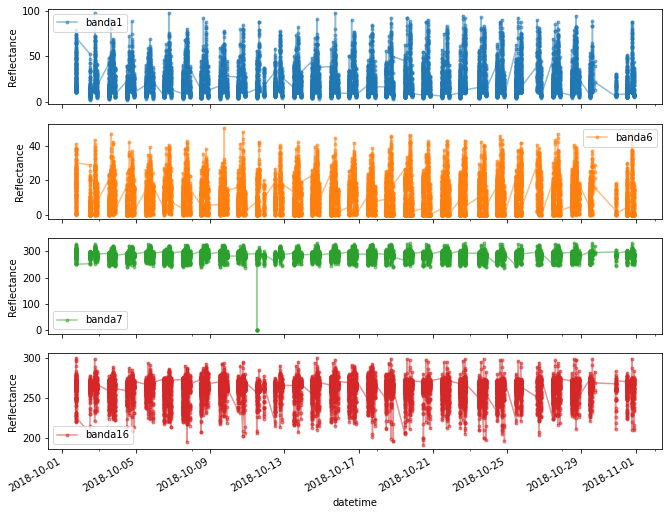

In [4]:
cols_plot = ['banda1', 'banda6', 'banda7', 'banda16']
bands = ['banda1', 'banda2', 'banda3', 'banda4', 'banda5', 'banda6', 'banda7', 'banda8',
         'banda9', 'banda10', 'banda11', 'banda12','banda13', 'banda14', 'banda15', 'banda16']
axes = df[cols_plot].plot(marker='.', alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes:
    ax.set_ylabel('Reflectance')

The same behavior can be observed when considering range values by station number.

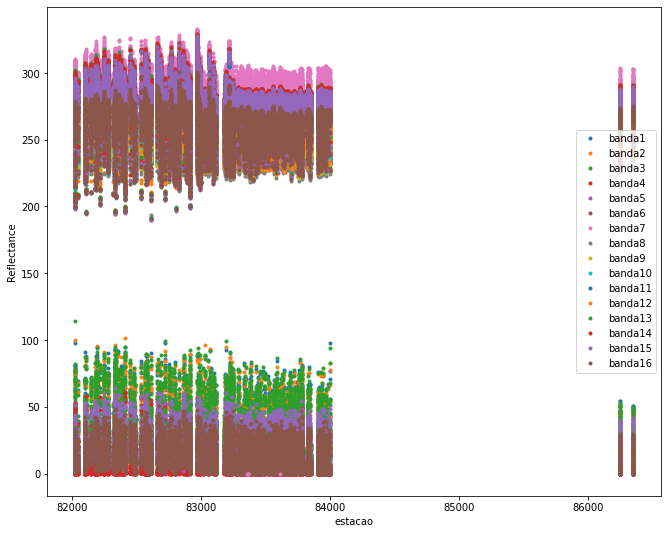

In [5]:
df.plot(x="estacao", y=range(4, 20), figsize=(11, 9), ylabel = "Reflectance", style='.');

There are discrete measurements for specific hours of the day producing gaps when ploting data as time series.

In [6]:
# Number of occurrences for each hour
print("Number of samples for each hour: \n", df['hour'].value_counts())
# Stations have different amount of data
#df['estacao'].value_counts()
#print("\nThere are " + str(len(df['estacao'].unique())) + " sounder stations!")

Number of samples for each hour: 
 12    6841
18    5805
21    1582
15    1514
Name: hour, dtype: int64


In [7]:
#df.loc['2018-10-01 12:00':'2018-10-31 12:00', 'banda4'].plot(figsize=(11,4), ylabel = "Reflectance", marker='.', linestyle='-');
fig = px.line(df, x='datetime', y="banda4")
fig.update_layout(xaxis_title='Datetime', yaxis_title='Reflectance')
fig.show()

Average operations can be applied to produce time series without gaps.

In [8]:
df_daily_mean = df.iloc[:, 4:20].resample("1d").mean()
data_table.DataTable(df_daily_mean, include_index=False, num_rows_per_page=10)

,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16
datetime,,,,,,,,,,,,,,,,
2018-10-01,30.412582,25.628075,29.361549,3.295164,21.882629,17.735962,291.433662,237.475117,246.231831,253.940376,273.669624,251.589531,275.738592,275.130751,273.320516,261.251972
2018-10-02,19.026901,15.794250,18.280526,1.101715,13.935731,10.841969,287.061365,238.356530,248.133177,256.577739,276.090624,251.648187,278.118947,277.907524,276.384191,263.729630
2018-10-03,21.452080,18.106551,21.076586,2.381698,15.070537,12.396083,283.487296,234.869047,243.776360,252.074575,271.117071,248.181317,272.814194,272.227626,270.553813,259.158198
2018-10-04,18.159843,14.562474,17.240087,1.661951,13.116080,10.729756,286.659477,235.125453,244.109477,253.256672,275.107892,250.388659,277.143902,276.657021,274.821394,262.322997
2018-10-05,20.176261,16.823809,19.826052,1.397043,16.068574,13.023774,289.268104,236.773426,246.150087,255.428609,276.283878,252.109235,278.321739,277.833757,276.053200,263.784939
2018-10-06,23.805798,20.636507,23.645018,3.155816,16.226720,13.965426,284.107624,233.790000,241.716170,249.763298,269.202004,249.414238,271.098777,270.348528,268.495656,258.172394
2018-10-07,24.584463,21.085282,24.152678,4.423716,14.623807,13.114517,281.145974,234.927468,241.829417,248.091111,265.881949,247.182605,267.679836,266.657851,264.656302,254.672532
2018-10-08,19.718031,16.045453,19.083990,1.711341,13.942003,11.063850,287.596359,239.626411,247.992125,254.757561,275.213990,251.794774,277.523014,277.109564,275.133641,262.428240
2018-10-09,19.209021,15.676066,18.340000,1.827867,12.849283,10.300035,285.767185,239.024301,247.773584,254.557675,274.164021,250.833864,276.279528,275.886538,274.053934,261.518706


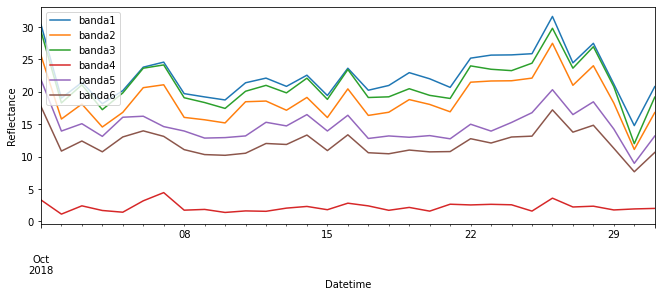

In [9]:
df.iloc[:, 4:10].resample("1d").mean().plot(figsize=(11,4), xlabel = "Datetime", ylabel = "Reflectance");

The histogram distribution of band 3 is shown.

Text(0.5, 0, 'Bins')

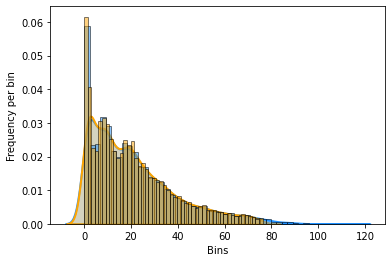

In [10]:
#fig = ff.create_distplot([df.banda3.to_numpy()], ["banda3"], show_rug=False)
#fig.show()
kwargs = dict(hist_kws={'alpha':.5, 'edgecolor':'black'}, kde_kws={'linewidth':2, 'shade':True})
sns.distplot(df[['banda3']], bins=50, color="dodgerblue", hist=True, label="banda3", **kwargs);
sns.distplot(clearBySigma(df[['banda3']], 3), bins=50, color="orange", hist=True, label="banda3_cleaned", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')

Text(0.5, 0, 'Bins')

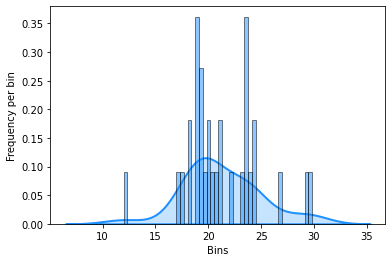

In [11]:
#fig = ff.create_distplot([df_daily_mean.banda3.to_numpy()], ["banda3"], show_rug=False)
#fig.show()
sns.distplot(df_daily_mean[['banda3']], bins=50, color="dodgerblue", hist=True, label="banda3", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')

The histogram distribution of band 13 is also shown.

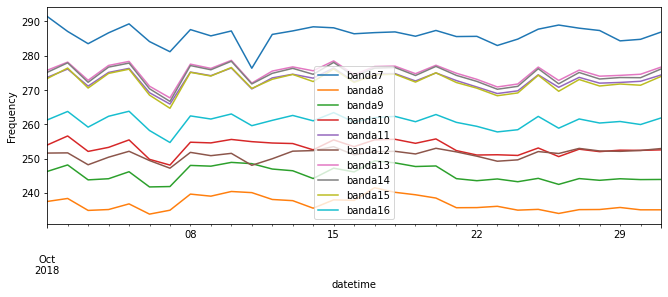

In [12]:
df.iloc[:, 10:20].resample("1d").mean().plot(figsize=(11,4), ylabel = "Frequency");

Text(0.5, 0, 'Bins')

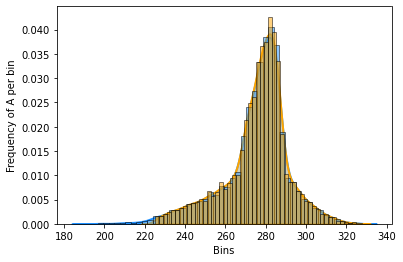

In [13]:
sns.distplot(df[['banda13']], bins=50, color="dodgerblue", hist=True, label="banda13", **kwargs);
sns.distplot(clearBySigma(df[['banda13']], 3), bins=50, color="orange", hist=True, label="banda13_cleaned", **kwargs);
plt.ylabel('Frequency of A per bin'); plt.xlabel('Bins')

Text(0.5, 0, 'Bins')

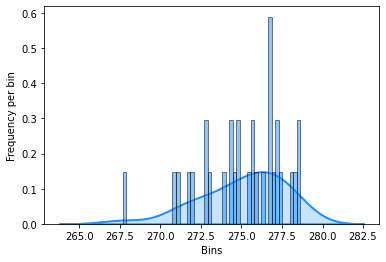

In [14]:
sns.distplot(df_daily_mean[['banda13']], bins=50, color="dodgerblue", hist=True, label="banda13", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')



---


**We now will apply the Cullen-Frey parameter space to classify all reflectance bands values.**

In [15]:
fig = px.scatter(df, x="datetime", y="banda16", color="estacao", title="Time series for band 16");
fig.update_traces(mode="markers", hovertemplate=None)
fig.update_layout(hovermode="y", xaxis_title='Datetime', yaxis_title='Reflectance'); fig.show()

In [16]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(df[bands]), columns=df[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,4.654964,2.103806,banda1
1,4.587965,2.045847,banda2
2,4.035064,1.371168,banda3
3,32.542404,21.092310,banda4
4,3.379455,0.813727,banda5
5,2.873564,0.524473,banda6
6,60.076685,9.922043,banda7
7,4.746041,0.163001,banda8
8,5.337821,0.760680,banda9
9,6.153017,1.778775,banda10


In [17]:
#cullenfrey(seriesList[maxIndex], bandParams)
#seriesList = makeList(df, len(df['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

As can be seen in the previous table, bands 4 and 7 are outside the limits considered for the Cullen-Frey graph produced with the plotly library. To observe these bands in the graph, it is necessary to pass as the first parameter the series with the highest kurtosi without being normalized to the cullenfreyPlotly function.


In [18]:
seriesList = makeList(df, len(df['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

We plot histograms for most of band time series, grouping it considering the probability density function (PDF) similarity.

In [19]:
bandseries = [df.banda9.to_numpy(), df.banda10.to_numpy(), df.banda11.to_numpy(), df.banda13.to_numpy(),
              df.banda14.to_numpy(), df.banda15.to_numpy(), df.banda16.to_numpy()]
names = ["banda9", "banda10", "banda11", "banda13", "banda14", "banda15", "banda16"]
#bandseries = [df.banda3.to_numpy()]; names = ["banda3"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()

In [ ]:
bandseries = [df.banda1.to_numpy(), df.banda2.to_numpy(), df.banda3.to_numpy(),
              df.banda4.to_numpy(), df.banda5.to_numpy(), df.banda6.to_numpy()]
names = ["banda1", "banda2", "banda3", "banda4", "banda5", "banda6"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()

In [ ]:
bandseries = [df.banda8.to_numpy(), df.banda12.to_numpy()]
names = ["banda8" , "banda12"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()


---

# **Grouping data to generate other time series**

In [ ]:
# Timeseries for days or hour considering stations
bandByDays = df.groupby(['day', 'estacao']).mean().reset_index()
bandByHours = df.groupby(['hour', 'estacao']).mean().reset_index()



---


## **Daily Series**

We aplyed daily average operation in reflectance values of each band grouping by sounding stations.

In [ ]:
data_table.DataTable(bandByDays, include_index=False, num_rows_per_page=10)

,day,estacao,latitude,longitude,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16,hour
0,1,82022,2.83,-60.70,11.800000,8.340000,23.930000,0.060000,21.520000,10.220000,310.040000,250.560000,260.270000,267.640000,298.680000,276.120000,302.370000,300.750000,296.010000,278.650000,18.0
1,1,82024,2.82,-60.65,11.420000,7.550000,27.650000,0.000000,19.170000,11.960000,309.590000,250.510000,260.140000,267.690000,297.220000,274.850000,301.080000,299.500000,295.240000,278.370000,18.0
2,1,82096,0.52,-50.42,54.380000,51.680000,58.150000,0.120000,52.980000,37.070000,305.030000,237.080000,247.270000,257.910000,276.510000,255.750000,278.950000,279.330000,278.260000,267.190000,18.0
3,1,82098,0.03,-51.05,54.500000,50.190000,57.300000,0.120000,49.360000,38.440000,305.100000,237.250000,247.520000,258.960000,276.930000,256.030000,279.140000,279.930000,279.270000,268.240000,18.0
4,1,82099,0.05,-51.07,56.660000,56.760000,58.280000,0.120000,49.490000,38.060000,305.350000,237.370000,247.520000,258.860000,276.980000,256.030000,279.320000,279.990000,279.330000,268.240000,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7353,31,83971,-30.00,-51.18,13.636667,8.606667,8.036667,0.123333,7.140000,6.260000,290.506667,235.433333,245.123333,254.720000,280.943333,260.966667,283.766667,283.200000,280.643333,268.053333,17.0
7354,31,83980,-31.33,-54.10,8.295000,2.835000,1.285000,0.060000,0.615000,0.490000,290.520000,239.510000,248.520000,257.340000,285.740000,265.040000,288.875000,288.455000,285.555000,271.710000,15.0
7355,31,83997,-33.52,-53.35,11.405000,5.055000,4.950000,0.060000,3.915000,4.550000,287.655000,237.370000,246.655000,256.120000,281.125000,261.140000,283.990000,283.820000,281.895000,269.695000,15.0
7356,31,86246,-25.35,-54.45,7.770000,2.120000,0.770000,0.000000,0.250000,0.080000,289.856667,239.470000,249.016667,258.576667,285.916667,265.330000,288.990000,288.743333,286.063333,272.516667,17.0


Below are examples of possible time series that can be filtered from the bandByDays dataframe.

In [ ]:
fig = px.line(bandByDays, y='banda16', title="Band 16 summarized by days and stations",
              hover_name = 'estacao', hover_data=["day"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False); 
fig.update_layout(hovermode="y", xaxis_title='Observations', yaxis_title='Reflectance'); fig.show()

In [ ]:
fig = px.line(bandByDays.query('estacao == 82022'), y='banda1', title="Band 1 summarized by days for a specific station",
              hover_name = 'estacao', hover_data=["day"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False); 
fig.update_layout(hovermode="y", xaxis_title='Observations', yaxis_title='Reflectance'); fig.show()

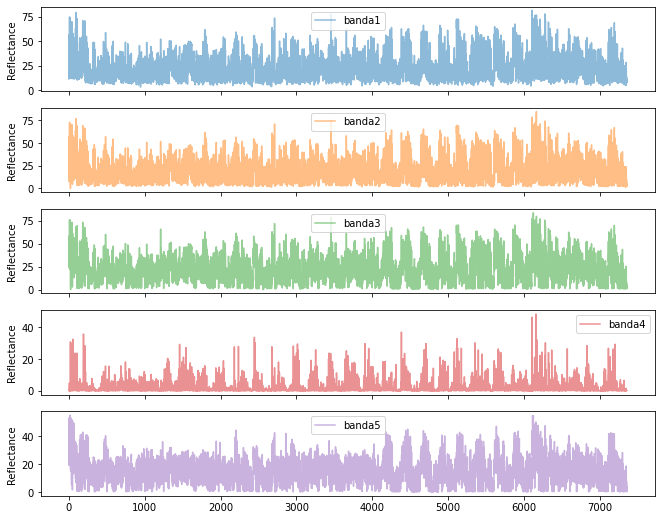

In [ ]:
axes = bandByDays[bands[0:5]].plot(alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes: ax.set_ylabel('Reflectance')

**We will also classify the data averaged by days in the Cullen-Frey parameter space and generate a histogram.**

In [ ]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(bandByDays[bands]), columns=bandByDays[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,3.944082,1.336750,banda1
1,3.811737,1.230943,banda2
2,3.393564,0.695876,banda3
3,21.000557,13.162357,banda4
4,3.334833,0.318244,banda5
5,2.760094,0.159422,banda6
6,131.793956,37.948299,banda7
7,3.761955,0.007395,banda8
8,4.155994,0.266610,banda9
9,4.929469,0.937101,banda10


In [ ]:
#maxIndex = np.argmax(bandParams['kurtosis'])
#cullenfrey(seriesList[maxIndex], bandParams)
#seriesList = makeList(bandByDays, len(bandByDays['banda1'])) # Uncomment this line for the graph to cover all time series
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

In [ ]:
fig = ff.create_distplot([bandByDays.banda3.to_numpy()], ["banda3"], show_rug=True); fig.show()



---


## **Series considering available hours**

We applyed hourly average operation in reflectance values of each band grouped considering stations. Remembering that each station has discrete measurements in some hours of the day (12, 15, 18 and 21).

In [ ]:
data_table.DataTable(bandByHours, include_index=False, num_rows_per_page=10) 

,hour,estacao,latitude,longitude,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16,day
0,12,82022,2.83,-60.70,23.315000,20.555357,29.651786,7.070714,15.135357,12.599286,286.505714,232.073929,239.433929,246.395000,267.607143,254.203214,269.416429,266.992143,263.704643,253.911429,15.678571
1,12,82024,2.82,-60.65,24.651786,22.528214,31.918929,6.561071,16.683571,13.673214,286.591071,232.606429,240.011786,247.019643,267.419643,253.929286,269.108571,266.936429,263.630357,254.257857,15.678571
2,12,82042,1.83,-61.13,21.091429,17.863214,23.198571,4.664643,12.863214,10.850714,289.442143,234.049286,242.044286,249.885000,273.512143,258.006071,275.591071,273.378571,269.862857,259.233214,15.678571
3,12,82096,0.52,-50.42,14.780800,11.549200,21.684400,1.623200,12.788800,10.148000,291.524400,238.559200,247.721200,256.312000,280.537600,258.445200,282.870800,282.150400,279.766400,266.133600,15.880000
4,12,82098,0.03,-51.05,17.823571,15.003571,23.356786,2.664643,15.623929,11.170000,289.860357,237.984286,246.586071,254.805000,278.444643,257.601786,280.637857,279.800000,277.446071,264.362500,15.678571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583,21,83937,-29.72,-53.70,17.940370,13.828148,13.655556,1.463704,9.844815,8.551852,286.305556,238.306296,247.442963,256.104815,276.215556,254.839630,278.345185,277.900000,276.008889,264.378148,15.518519
584,21,83952,-29.93,-51.13,16.083704,11.403704,11.210741,1.120370,7.931111,6.729259,286.566296,238.094444,247.534074,255.952222,276.851852,253.999630,279.074815,278.763333,276.757037,264.355926,15.518519
585,21,83971,-30.00,-51.18,18.144815,15.029630,13.937407,1.387037,9.340000,7.150000,286.074815,237.820000,247.189259,255.502963,276.129259,253.522963,278.255926,277.833704,275.828519,263.531481,15.518519
586,21,86246,-25.35,-54.45,15.641481,11.157037,11.160741,1.619630,8.084074,8.084074,286.852593,240.531111,249.811481,257.958519,276.370370,255.988519,278.385926,277.823704,275.956296,264.747407,15.518519


Below are examples of possible time series that can be filtered from the bandByHours dataframe.

In [ ]:

fig = px.line(bandByHours, y="banda16", title="Band 16 summarized by hours and stations",
               hover_name = 'estacao', hover_data=["hour"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False)
fig.update_layout(hovermode="y", xaxis_title='Observations', yaxis_title='Reflectance'); fig.show()

In [ ]:

fig = px.line(bandByHours.query('estacao == 82022'), y="banda16", title="Band 16 summarized by hours for a specific station",
               hover_name = 'estacao', hover_data=["hour"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False)
fig.update_layout(hovermode="y", xaxis_title='Observations', yaxis_title='Reflectance'); fig.show()

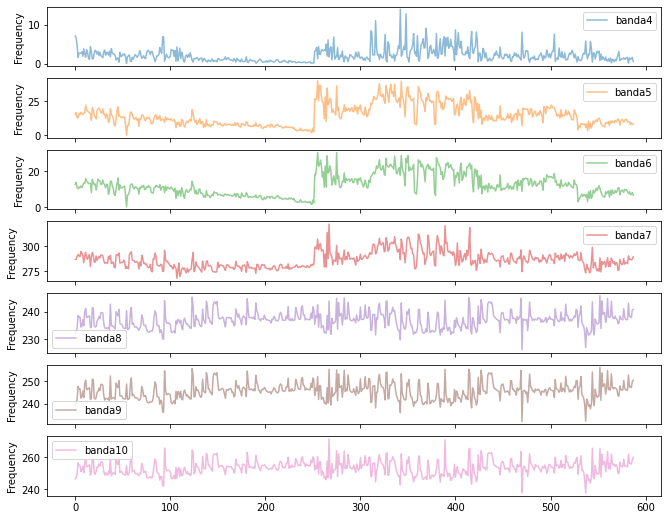

In [ ]:
axes = bandByHours[bands[3:10]].plot(alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes:
    ax.set_ylabel('Frequency')

**We also classify the data averaged by hours in the Cullen-Frey parameter space and generate a histogram.**

In [ ]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(bandByHours[bands]), columns=bandByHours[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,3.183256,0.329106,banda1
1,4.047391,0.717258,banda2
2,3.127782,0.672527,banda3
3,10.257237,4.812742,banda4
4,3.104625,0.687614,banda5
5,2.811755,0.451862,banda6
6,4.359367,0.965962,banda7
7,3.397235,0.098019,banda8
8,3.518760,0.077803,banda9
9,3.773268,0.113729,banda10


In [ ]:
#maxIndex = np.argmax(bandParams['kurtosis'])
#cullenfrey(seriesList[maxIndex], bandParams)
seriesList = makeList(bandByHours, len(bandByHours['banda1'])) # Uncomment this line for the graph to cover all time series
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

In [ ]:
bandseries = [bandByHours.banda3.to_numpy(), bandByHours.banda4.to_numpy()]
fig = ff.create_distplot(bandseries, ["banda3", "banda4"], show_rug=True); fig.show()